In [ ]:
import sys
sys.path.insert(0,'./python')
from readSent import *
import numpy 
from numpy import clip, where
from scipy.ndimage.morphology import *
import xml.etree.cElementTree as ET


class classification(object):
    
    def __init__(self, fhead = 'data/50SMG20164100', bands = (2,3,4,8,11,12)):
        self.fhead = fhead
        self.bands = bands
        self.t1_max = 0.25
        self.t1_min = 0.07
        self.t2_max = 0.2
        self.t2_min = -0.1
        self.t3_max = 0.42
        self.t3_min = 0.2
        self.t4_max = 0.35
        self.t4_min = 0.15
        self.t5_max = 0.22
        self.t5_min = 0.18
        self.t6_max = 0.95
        self.t6_min = 0.85
        self.t7_eb12 = 0.35
        self.t7_sp = 0.73 #(0.9^5 5 means 5 processes)
        self.t8_max = 0.2
        self.t8_min = 0.02
        self.t9_max = 1.6
        self.t9_min = 1.
        #self.t10_max = 0.32
        #self.t10_min = 0.15
        self.t10_max = 0.9
        self.t10_min = 0.6
        self.t11_1 = 0.034
        self.t11_2 = 0.2
        self.t12_max = 0.21
        self.t12_min = 0.07
        self.t13_max = 1.1
        self.t13_min = 0.9
        self.t14_max = 6.
        self.t14_min = 3.
        self.c_pt = 0.015
        #self.t15_max = 
        #self.t15_min = 0.07
        #self.t16_max = 0.35
        #self.t16_min = 0.16
        self.cm = []
        self.sm = []
        self.wm = []
        self.bsm= []
        self.vm = []
        self.tempM = []
        self.bssm = []
        
        self.b2 = img['B02']
        self.b4 = img['B04']
        self.b3 = img['B03']
        self.b8 = img['B08']
        self.b11 = img['B11']
        self.b12 = img['B12']
        self.b8a = img['B8A']
         
        
        
        
        
    def Ratio(self, data, minm, maxm): # get the posibility of the values within specific bound
        _ratio = (data-minm)/(maxm-minm)
        return _ratio
    
    def Posb(self, p1, p2): # get the combined possibility of two array
        _posb = p1*p2
        return _posb
    
    def CombinM(self, m1, m2,t = True): # combination of two mask either & or | operator
        if t:
            m = m1 & m2
        else:
            m = m1 | m2
        
        return m
    
    def Getimg(self, fhead = 'data/50SMG20164100', bands = (2,3,4,8,11,12)): # read in the img data
        
        img = readimg('%s'%fhead,bands)
        '''
        self.b2 = img['B02']
        self.b4 = img['B04']
        self.b3 = img['B03']
        self.b8 = img['B08']
        self.b11 = img['B11']
        self.b12 = img['B12']
        self.b8a = img['B8A']
        '''
    
    def ScaleExtent(self, data): # used for unifine different array, 
        

        shape = (10980,10980)
        re = int(shape[0]/(data.shape[0]))
        return np.repeat(np.repeat(data, re, axis = 1), re, axis =0)
        
        
        #shape = self.b2.shape # and fill corresponding values with samll scale values
        #step = int(shape[0]/(data.shape[0]))
        #zArray = numpy.zeros(shape)
        #zArray[::2,::2] = data; zArray[1::2,::2] = data; zArray[::2,1::2]=data; zArray[1::2,1::2]=data
        #return zArray
    
    def M_P_func(self, data, minm, maxm, nm = 1):
        ca = clip(data, minm, maxm)
        r = self.Ratio(ca, minm, maxm)
        if nm == 1:
            m = ca > minm
        elif nm == 2:
            m = ca < minm
        elif nm == 3:
            m = ca > maxm
        elif nm == 4:
            m = ca < maxm
        else:
            pass
        return (r, m)
    
    def _del(self, v):
        for i in v:
            del i
    
    def _p1(self): # process 1 using the band 4 with thresh 1 (t1_max and t1_min)
        
        self.p1p, self.p1m = self.M_P_func(self.b4, self.t1_min, self.t1_max)
        #ca = clip(self.b4, self.t1_min, self.t1_max)
        #self.Ratio(ca, self.t1_min, self.t1_max)
        #self.tempP = self.ratio
        #self.tempcm = ca>self.t1_min
    
    def _p2(self): # precess 2 using the NDSI with thresh 2
        
        self.eb11 = self.ScaleExtent(self.b11)
        self.NDSI = (self.b3 - self.eb11)/(self.eb11 + self.b3)
        self.p2p, self.p2m = self.M_P_func(self.NDSI, self.t2_min, self.t2_max)
        #ca = clip(self.NDSI, sefl.t2_min, self.t2_max)
        #self.Ratio(ca, self.t2_min, self.t2_max)
        self._del(self.b11)
    
        # combination of previous 2 stadges
        self.p1_p2_P = self.Posb(self.p1p, self.p2p)
        self.p1_p2_M = self.CombinM(self.p2m, self.p1m)
        #self.cm = sefl.combinm
        #self.tempP = self.ratio
        self._del([self.p1p, self.p2p, self.p1m, self.p2m]) # delet variables
    
    
    
    # snow detection and get the cloud mask  
    
    def _p3(self): # NDSI snow detection
        
        self.p3p, self.p3m = self.M_P_func(self.NDSI, self.t3_min, self.t3_max)
        #ca = clip(self.NDSI, sefl.t3_min, self.t3_max)
        #self.Ratio(ca, self.t3_min, self.t3_max)
        #self.sratio = self.ratio
        #self.tempsm = ca > self.t3_min
    
    def _p4(self): # b8 snow
        
        self.p4p, self.p4m = self.M_P_func(self.b8, self.t4_min, self.t4_max)
    
    def _p5(self): # b2 snow
        
        self.p5p, self.p5m = self.M_P_func(self.b2, self.t5_min, self.t5_max)
    
    def _p6(self): # b2/b4 snow
        
        b2_b4 = self.b2/self.b4
        
        self.p6p, self.p6m = self.M_P_func(b2_b4, self.t6_min, self.t6_max)
    
    
    
    
    def _p7(self): # dilation for snow adjacent pixels 
        
        self.sm = numpy.ones(self.b2.shape).astype(bool)
       
        for i in [self.p3m, self.p4m, self.p5m, self.p6m]:
            self.sm = self.CombinM(i, self.sm)
        
        self.eb12 = self.ScaleExtent(self.b12)
        self._del(self.b12)
        b12m = self.eb12 < self.t7_eb12
        
        struct = iterate_structure(generate_binary_structure(2,1), 3)
        snow_mask_dil = binary_dilation(self.sm, struct)
        bz = snow_mask_dil -  self.sm
        bs = bz & b12m
        #print bs
        self.sm = self.CombinM(bs, self.sm, t=False)
        
        self.sp = numpy.ones(self.b2.shape)
        
        for i in [self.p3p, self.p4p, self.p5p, self.p6p]:
            self.sp = self.Posb(i,self.sp)
            
        
        S_p_m = self.sp > self.t7_sp #use the finnal possibility to thershold (0.73 for his) the snow mask
        self.sm = self.CombinM(self.sm, S_p_m)
        
        S_free = ~self.sm
        
        self.cm = self.p1_p2_M & S_free
        
        
        #self.p7p, self.p7m = M_P_func(b2_b4, self.t7_min, self.t7_max)
    def _p8(self):
        
        self.NDVI = (self.b8 - self.b4)/(self.b8 + self.b4)
        p8p, self.p8m = self.M_P_func(self.NDVI, self.t8_min, self.t8_max, nm = 4) 
        self.p8p =  p8p*-1 + 1
        self.vm = ~ self.p8m
        
    
    def _p9(self):
        
        b8_b3 = self.b8/self.b3
        p9p, self.p9m = self.M_P_func(b8_b3, self.t9_min, self.t9_max, nm=4)
        self.p9p = 1. - p9p
        
    def _p10(self):
        
        b2_b11 = self.b2/self.eb11
        
        b2_FT = clip(-0.4*b2_b11 + 0.46, 0.15, 0.32)        
        
        self.bsm = (self.b2 < b2_FT) & (b2_b11 < 0.6) #bare soil
        #self.tempM = (self.b2_b11 > 0.6) & (self.b2_b11 < 0.9) & (self.b2 < b2_FT)
        self.p10p, p10m = self.M_P_func(b2_b11, self.t10_min, self.t10_max)
        self.p10m = p10m & ~(self.b2 < b2_FT)
        #self.b2_FT = b2_FT
        #self.b2_b11 = b2_b11
     
    # water bodies
    def _p11(self):
        
        self.eb8a = self.ScaleExtent(self.b8a)
        d_b2_b4 = self.b2-self.b4
        self.wm = (d_b2_b4 > self.t11_1) & (self.eb8a < self.b4) & (self.b2 < self.t11_2)
        
        self.p11m = ~self.wm 
        self.p11p = 1.
    
    def _p12(self):
        
        b2_b11 = self.b2/self.eb11
        B12_FT = clip(b2_b11*0.1 - 0.09, self.t12_min, self.t12_max)
        self.wm2 = where((b2_b11 > 4.) & (self.eb12 < B12_FT) & (self.eb8a < self.b4) & (self.b2 < 0.2), True, False)
    
        R15_AMB = (b2_b11 < 4.) & (b2_b11 >= 2.) & (self.eb12 < B12_FT) & (self.eb8a < self.b4) & (self.b2 < 0.2)

        #if(R15_AMB.size > 0):
         #   a = -1 / (T22_R_B02_B11 - T21_R_B02_B11)
         #   b = -T21_R_B02_B11 * a + 1
         #   self.p12p = a * R_B02_B11 + b        

        self.wm = R15_AMB | self.wm | self.wm2
        self.p12m = ~self.wm
        self.p12p = 1.
    
    # sand and stone in desert
    def _p13(self):
        
        b8a_b11 = self.eb8a/self.eb11
        b2_FT = clip(b8a_b11*(-0.25)+0.475, 0.16, 0.35)
        self.Dssm = (self.b2 < b2_FT) & (b8a_b11 < 0.9) & (self.b2 < 0.8)
        self.p13p, p13m = self.M_P_func(b8a_b11, self.t13_min, self.t13_max)
        self.p13m = p13m & ~(self.b2 < b2_FT)
        
        
        self.b2_FT = b2_FT
        self.b8a_b11 = b8a_b11
    
    def _p14(self):
        
        b4_b11 = self.b4/self.eb11
        p14p, self.p14m = self.M_P_func(b4_b11, self.t14_min, self.t14_max, nm = 4)
        self.p14p = 1. - p14p
    
    def Get_cm_p(self):
        print 'please fist get the img using Getimg() function'
      
        
        print 'process 1...'
        self._p1()
        print 'process 2...'
        self._p2()
        print 'process 3...'
        self._p3()
        print 'process 4...'
        self._p4()
        print 'process 5...'
        self._p5()
        print 'process 6...'
        self._p6()
        print 'process 7...'
        self._p7()
        print 'process 8...'
        self._p8()
        print 'process 9...'
        self._p9()
        print 'process 10...'
        self._p10()
        print 'process 11...'
        self._p11()
        print 'process 12...'
        self._p12()
        print 'process 13...'
        self._p13()
        print 'process 14...'
        self._p14()
        
        
        for i in [self.p8m, self.p9m, self.p10m, self.p11m, self.p12m, self.p13m, self.p14m]:
            self.cm = self.CombinM(i, self.cm)
        
        self.cp = self.p1_p2_P
        for i in [self.p8p, self.p9p, self.p10p, self.p11p, self.p12p, self.p13p, self.p14p]:
            self.cp = self.Posb(i,self.cp)
        
        c_ptm = self.cp > self.c_pt
        self.fcm = self.cm & c_ptm
        
        v = [self.p8m, self.p9m, self.p10m, self.p11m, self.p12m, self.p13m, self.p14m, 
                  self.p8p, self.p9p, self.p10p, self.p11p, self.p12p, self.p13p, self.p14p]
        self._del(v)

In [1]:
import numpy.ma as ma
import pylab as plt
%matplotlib inline
import sys
sys.path.insert(0,'./python')
from readSent import *
img = readfile((2,3,4,8,11,12,13), 'data/50SMG20164100')

data/50SMG20164100auxiliaryECMWFT
data/50SMG20164100metadata.xml


In [2]:
from classification import *
l = classification(img = img)

In [3]:
l.Get_cm_p()

process 1...
process 2...
process 3...
process 4...
process 5...
process 6...
process 7...
process 8...
process 9...
process 10...
process 11...
process 12...
process 13...
process 14...


In [4]:
vm = l.vm
wm = l.wm
wm2 = l.wm2
wm3 = l.wm3
bsm = l.bsm
Dssm = l.Dssm
sm = l.sm
NDVI = l.NDVI
fcm = l.fcm
cm = l.cm
cp = l.cp
b2 = l.b2
b3 = l.b3
b4 = l.b4
b8 = l.b8
b8a = l.eb8a
b11 = l.eb11
b12 = l.eb12
del l

In [13]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import numpy as np
'''
plt.figure()
ax = plt.gca()
im = ax.imshow(np.arange(100).reshape((10,10)))

# create an axes on the right side of ax. The width of cax will be 5%
# of ax and the padding between cax and ax will be fixed at 0.05 inch.
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)

plt.colorbar(im, cax=cax)
'''

def dimg(data, b=False, step=1, cbar = True):
    if b:
        plt.figure(figsize=(15,15))
        ax = plt.gca()
        im = ax.imshow(data[::step, ::step])
        
    else:
        plt.figure()
        ax = plt.gca()
        im = ax.imshow(data[::step,::step])
        
    if cbar:
        # create an axes on the right side of ax. The width of cax will be 5%
        # of ax and the padding between cax and ax will be fixed at 0.05 inch.
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.1)
        plt.colorbar(im, cax=cax)
    else:
        pass


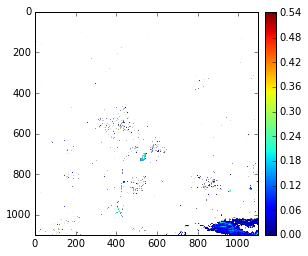

In [14]:
dimg(ma.array(cp, mask=~cm), step=10)

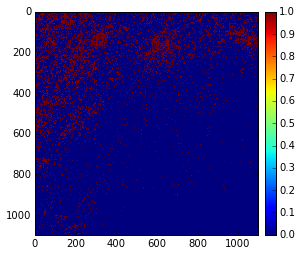

In [14]:
dimg(bsm, step = 10)

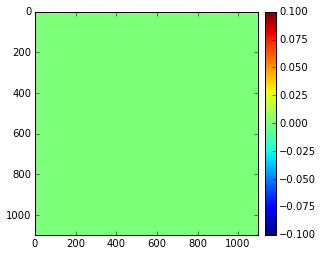

In [15]:
dimg(sm,step = 10)

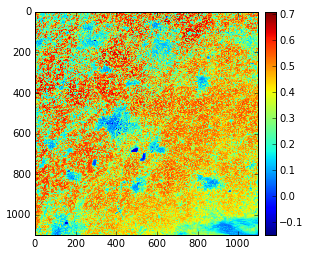

In [16]:
dimg(NDVI, step = 10)

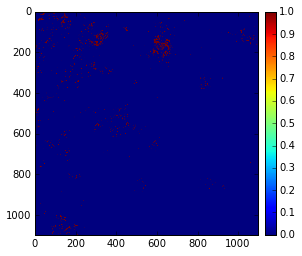

In [19]:
dimg(Dssm,step=10)

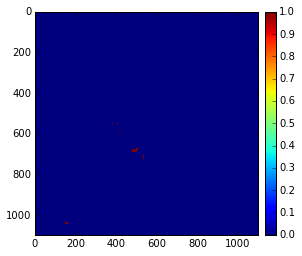

In [46]:
dimg(wm, step=10)

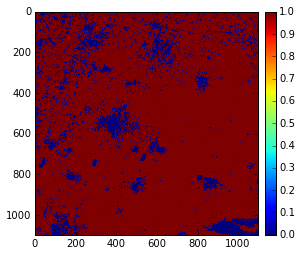

In [20]:
dimg(vm, step = 10)

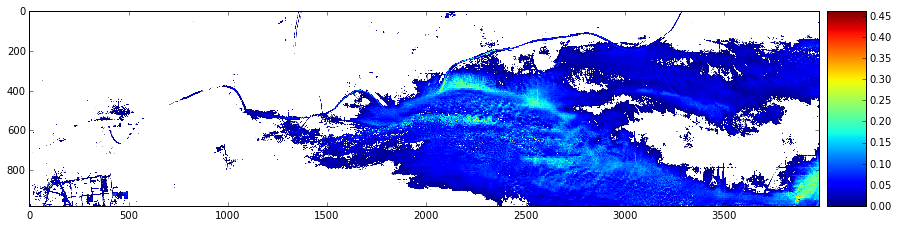

In [22]:
cloud = ma.array(cp, mask=~cm)
dimg(cloud[10000:,7000:], b =1)

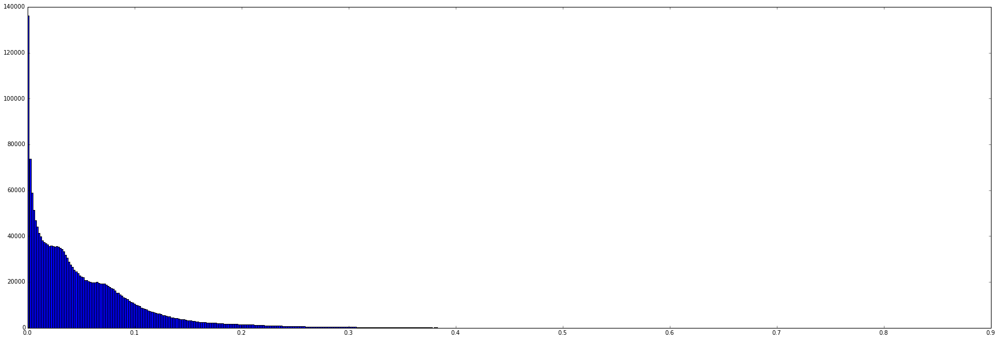

In [23]:
plt.figure(figsize=(30,10))
n, bins, patches = plt.hist(np.unique(cloud),bins=500)

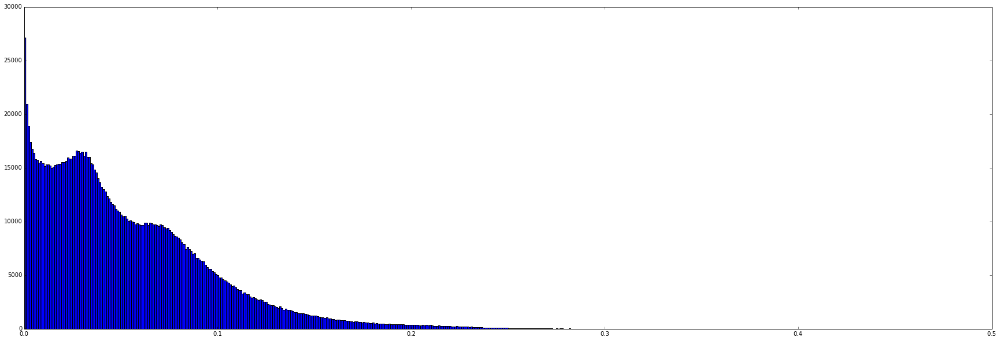

In [24]:
plt.figure(figsize=(30,10))
n, bins, patches = plt.hist(np.unique(cloud[10000:,7000:]),bins=500)

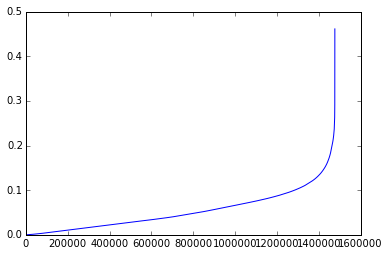

In [25]:
plt.plot(np.unique(cloud[10000:,7000:]))

In [27]:
# from the histgram choose 0.015 as the probability threshold for thr final cloud detection
fcm = cp>0.04b 

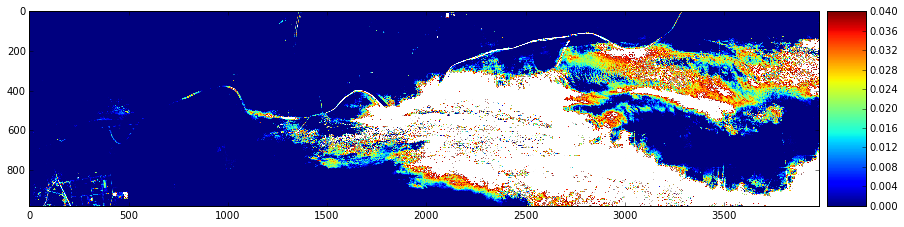

In [29]:
cloud = ma.array(cp, mask=fcm)
dimg(cloud[10000:,7000:], b=1)

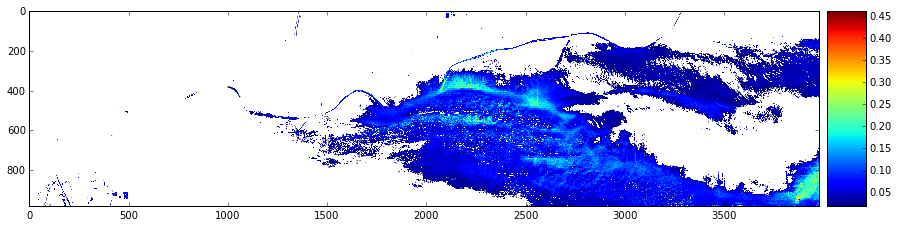

In [32]:
fcm = cp>0.02
cloud = ma.array(cp, mask=~fcm)
dimg(cloud[10000:,7000:], b = 1)

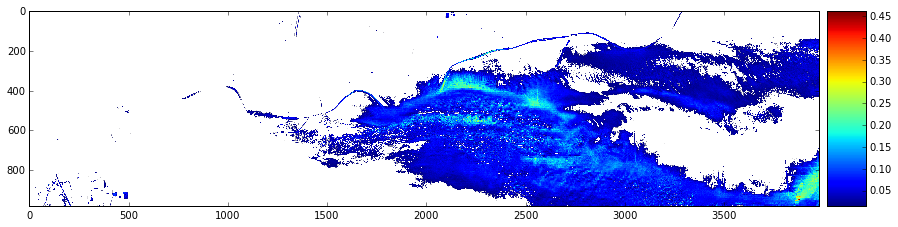

In [34]:
fcm = cp>0.015
cloud = ma.array(cp, mask=~fcm)
dimg(cloud[10000:,7000:], b=1)

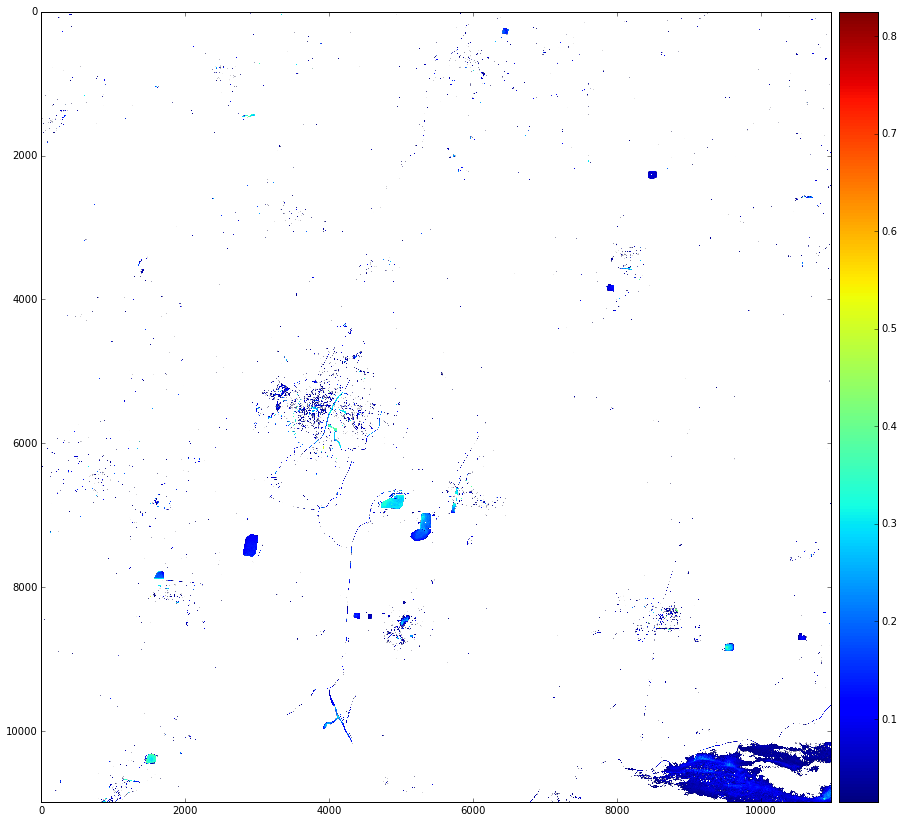

In [36]:
# all cloud
cloud = ma.array(cp, mask=~fcm)
dimg(cloud, b=1)

In [47]:
# low prob cloud 0.015-0.03, medium 0.03-0.075, high 0.075 and above
lc_m = (0.015<cp) & (cp <= 0.03)
l_c = ma.array(cp, mask=~(lc_m&cm))
mc_m = (0.03<cp) & (cp <= 0.075)
m_c = ma.array(cp, mask=~(mc_m&cm))
hc_m = cp > 0.075
h_c = ma.array(cp, mask=~(hc_m&cm))

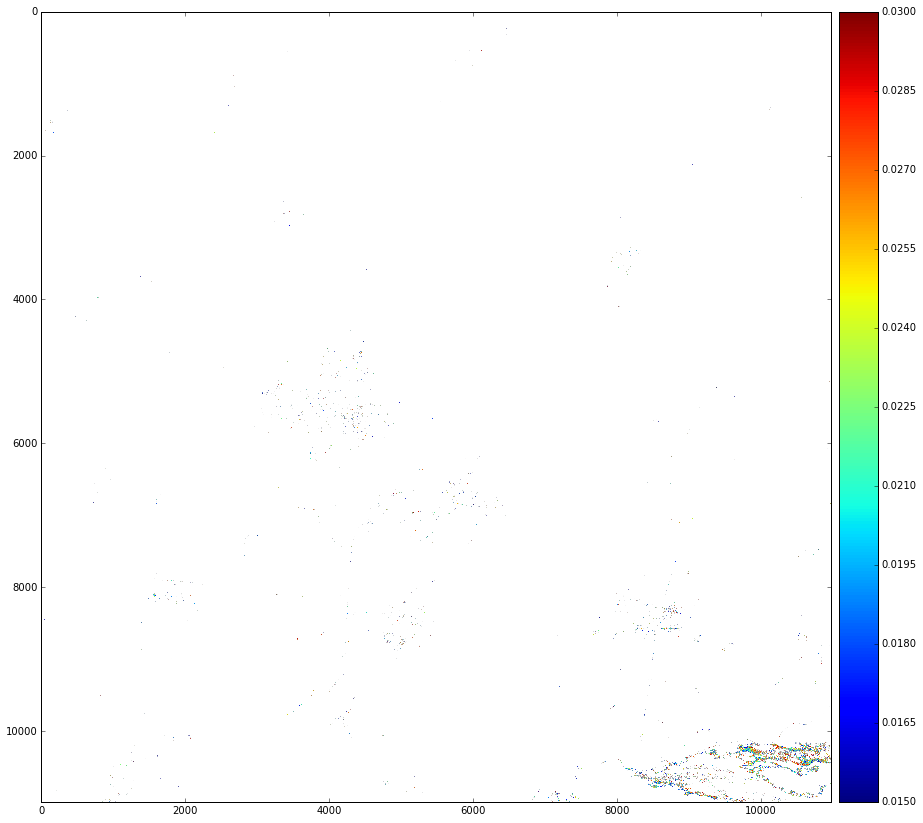

In [48]:
dimg(l_c, b = True)

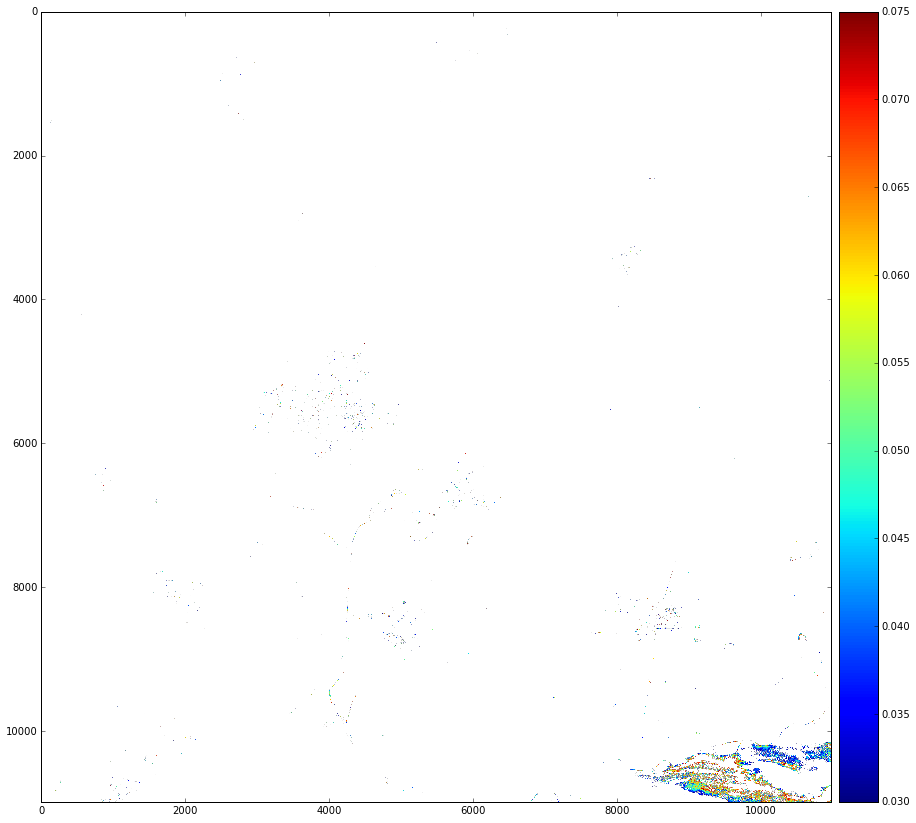

In [49]:
dimg(m_c, b = True)

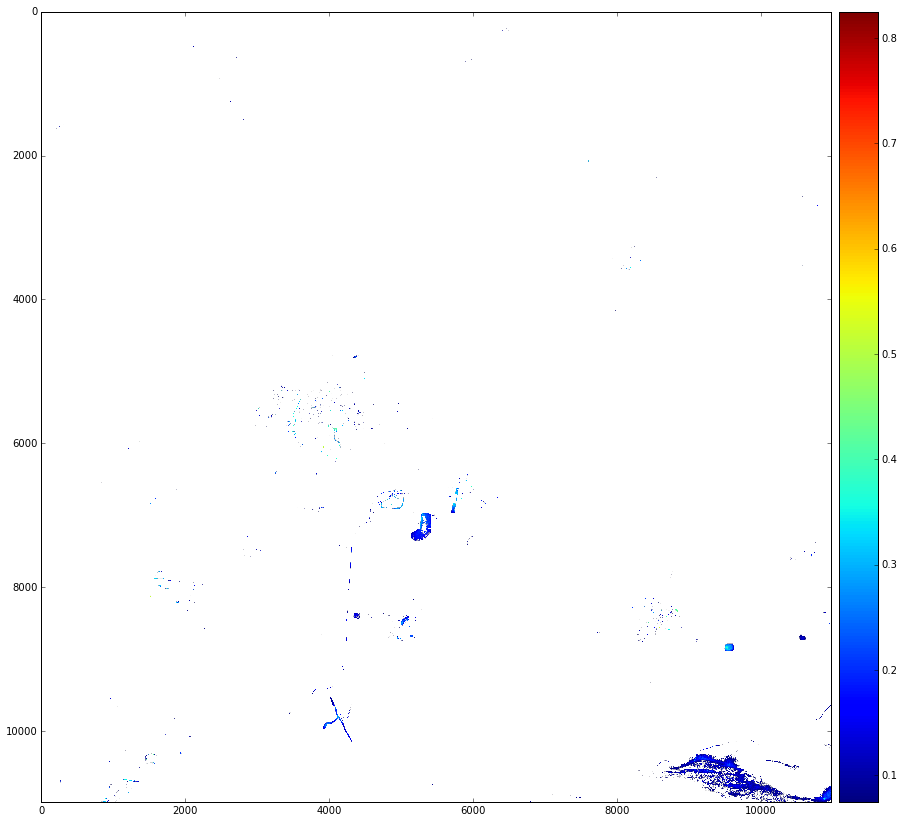

In [50]:
dimg(h_c, b = True)

In [54]:
lcm = lc_m&cm
mcm = mc_m&cm
hcm = hc_m&cm

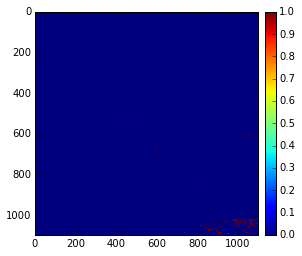

In [55]:
dimg(lcm,step = 10)

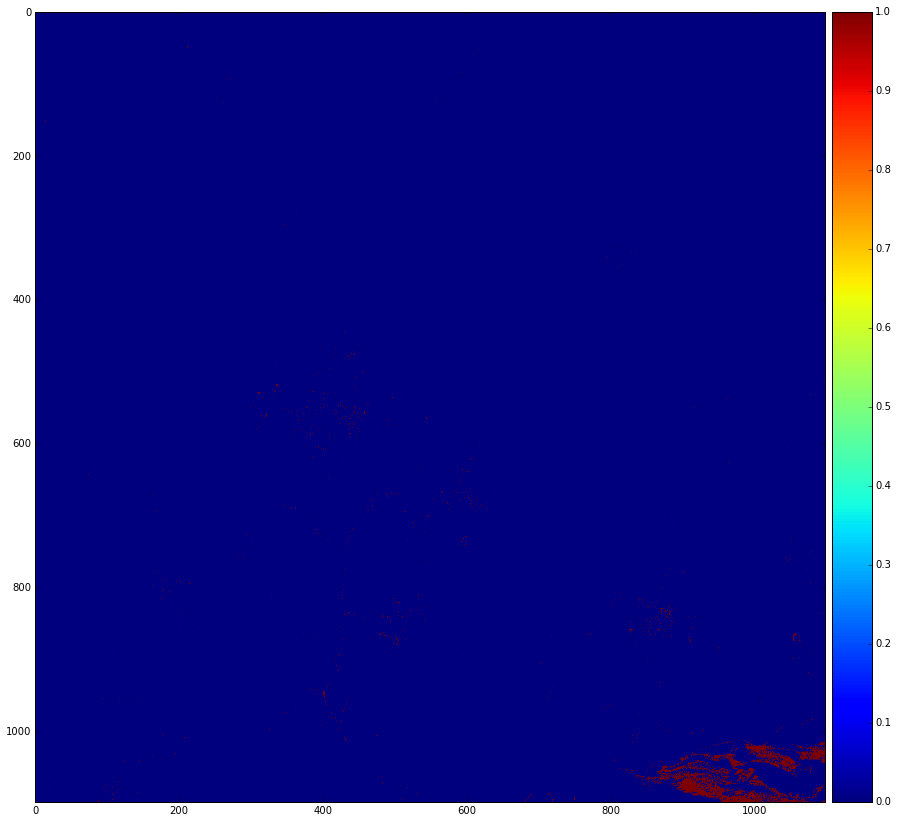

In [61]:
dimg(mcm,1, step=10)

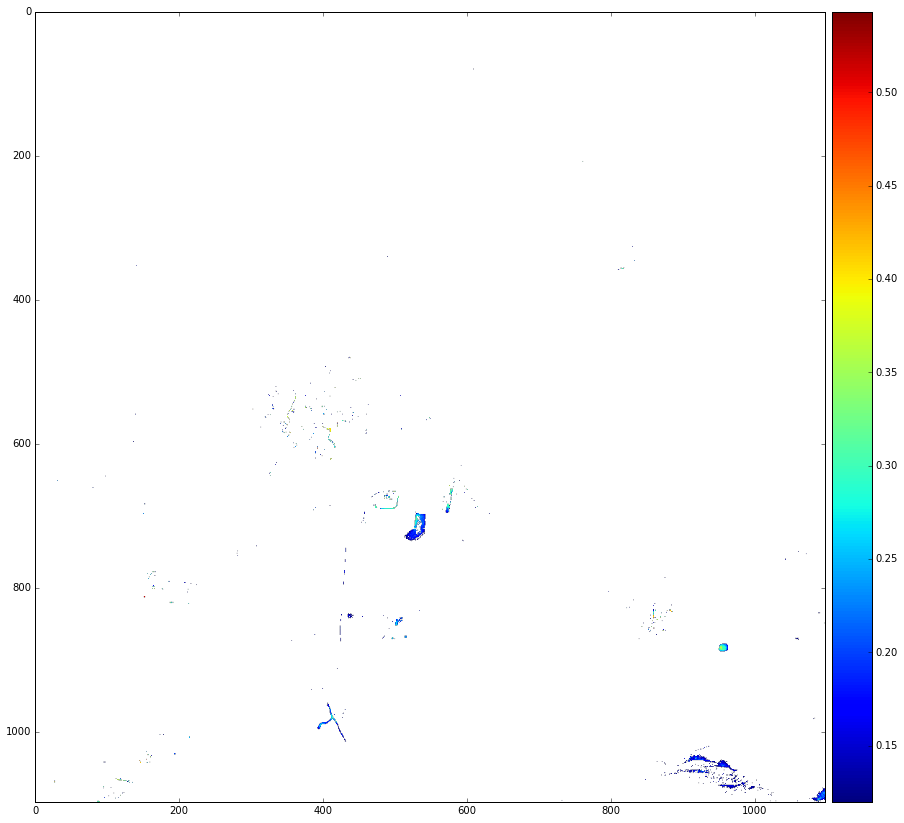

In [84]:
hc_m = cp > 0.12
h_c = ma.array(cp, mask=~(hc_m&cm))
dimg(h_c,1,step = 10)

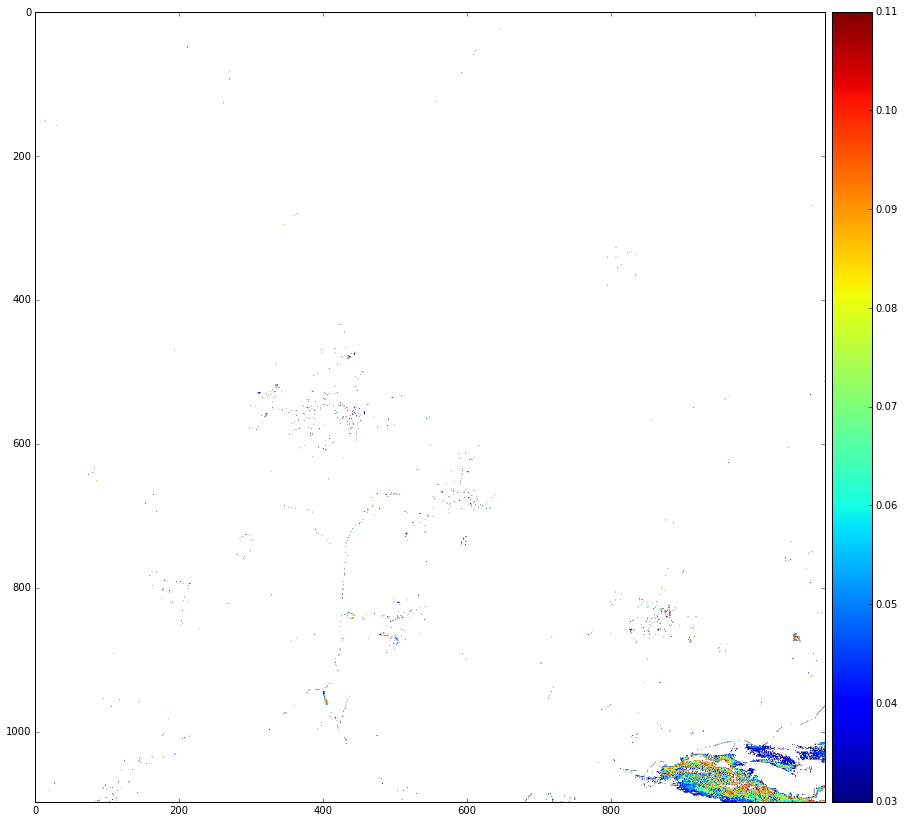

In [15]:
mc_m = (cp < 0.11) & (cp>0.03)
h_c = ma.array(cp, mask=~(mc_m&cm))
dimg(h_c,1,step = 10)

In [2]:
import cPickle as pkl
def pkl_f(f_wr, o = None):
    if o == 'r':
        return pkl.load(open(f_wr['name'], 'rb'))
    elif o == 'w':
        pkl.dump(f_wr.values()[0], open(f_wr.keys()[0], 'wb'))
    else:
        print "please specify operation as 'r'or 'w' for reading and writing"         

In [15]:
mn = [i+'.pkl' for i in 'vm,wm,wm2,wm3,bsm,Dssm,sm,NDVI,fcm,cm,cp,m_cm'.split(',')]
ms = [vm,wm,wm2,wm3,bsm,Dssm,sm,NDVI,fcm,cm,cp,mc_m]
masks = [{i[0]:i[1]} for i in zip(mn,ms)]

In [16]:
names = [i+'.pkl' for i in 'b1,b2,b3,b4,b5,b6,b7,b8,b8a,b9,b10,b11,b12'.split(',')]
d = [b1,b2,b3,b4,b5,b6,b7,b8,b8a,b9,b10,b11,b12]
bands = [{i[0]:i[1]} for i in zip(names,d)]

In [19]:
from functools import partial

pars = partial(pkl_f,o = 'w')
pool = multiprocessing.Pool(processes=16)
pool.map(pars,masks)
pool.close()
pool.join()
print 'finished 1'
pars = partial(pkl_f,o = 'w')
pool = multiprocessing.Pool(processes=16)
pool.map(pars,masks)
pool.close()
pool.join()

print 'all finished'
#pkl_f(mcm, 'w', 'pkls/mcm.pkl')
#pkl_f(lcm, 'w', 'pkls/lcm.pkl')
#pkl_f(lcm, 'w', 'pkls/lcm.pkl')

finished 1
all finished


In [5]:
import sys
sys.path.insert(0,'./python')
from readSent import *
files = readfile([1,5,6,7,9,10],'data/50SMG20164100')

data/50SMG20164100auxiliaryECMWFT
data/50SMG20164100metadata.xml


In [6]:
b5 = files['B05']
b6 = files['B06']
b10 = files['B10']
b9 = files['B09']
b7 = files['B07']
b1 = files['B01']

In [7]:
def ScaleExtent( data): # used for unifine different array, 
    shape = (10980,10980)
    re = int(shape[0]/(data.shape[0]))
    return np.repeat(np.repeat(data, re, axis = 1), re, axis =0)

In [8]:
import numpy as np
a = []
for i in [b1,b5,b6,b7,b9,b10]:
    a.append(ScaleExtent(i))
b1,b5,b6,b7,b9,b10 = a

In [9]:
sb = """443	20
490	65
560	35
665	30
705	15
740	15
783	20
842	115
865	20
945	20
1380	30
1610	90
2190	180"""
sb= [i.split('\t') for i in sb.split('\n')]
wl = [float(i) for i,j in sb]

In [10]:
bs = [b1,b2,b3,b4,b5,b6,b7,b8,b8a,b9,b10,b11,b12]

In [11]:
x = 5003
y = 6002
bs = [b1,b2,b3,b4,b5,b6,b7,b8,b8a,b9,b10,b11,b12]
def plot_spec(x,y, bs):
    p_r = []
    print x,y
    for i in bs:
        p_r.append(i[x,y])
    plt.plot(wl,p_r, )
    plt.ylim([0,1.])
    #plt.title('Spetral Property')
    plt.ylabel('TOA reflectance')
    plt.xlabel('wavelength (nm)')
    for i in wl:
        line = plt.plot([i,i],[0,1],'--')
        plt.setp(line, linewidth=0.5, color='gray')
        

5003 6002


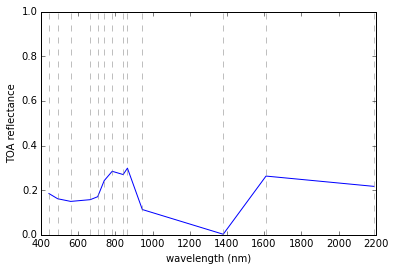

In [35]:
plot_spec(x,y,bs)

In [ ]:
mn = 'vm,wm,wm2,bsm,Dssm,sm,NDVI,fcm,cm,cp'.split(',')
ms = [vm,wm,wm2,bsm,Dssm,sm,NDVI,fcm,cm,cp]
masks = {i:j for i,j in zip(mn,ms)}

In [ ]:
print files.keys()

In [ ]:
aux_n = [x for x in files.keys() if not x.startswith('B') ]
aux = {i:files[i] for i in aux_n}

In [ ]:
Sent_data = {'bands':bands,'masks':masks,'aux':aux}

In [ ]:
pkl_f('w',Sent_data,'pkls/test1.pkl')

In [156]:
v_p = np.where(Dssm)

In [157]:
indx = np.arange(len(v_p[0]))

2060 5818


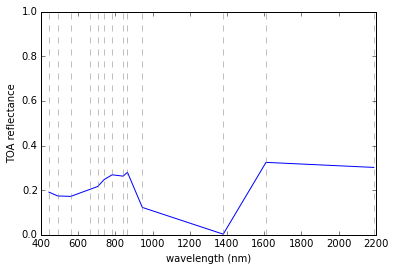

In [158]:
ind = np.random.choice(indx)
p_x = v_p[0][ind]
p_y = v_p[1][ind]
print p_x,p_y
plot_spec(p_x,p_y,bs)

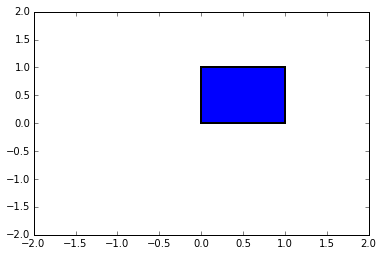

In [160]:
import matplotlib.pyplot as plt
from matplotlib.path import Path
import matplotlib.patches as patches

verts = [
    (0., 0.), # left, bottom
    (0., 1.), # left, top
    (1., 1.), # right, top
    (1., 0.), # right, bottom
    (0., 0.), # ignored
    ]

codes = [Path.MOVETO,
         Path.LINETO,
         Path.LINETO,
         Path.LINETO,
         Path.CLOSEPOLY,
         ]

path = Path(verts, codes)

fig = plt.figure()
ax = fig.add_subplot(111)
patch = patches.PathPatch(path, facecolor=None, lw=2)
ax.add_patch(patch)
ax.set_xlim(-2,2)
ax.set_ylim(-2,2)
plt.show()


In [9]:
mc_m = (cp < 0.11) & (cp>0.03) & cm
w_p = np.where(mc_m)
a = np.arange(len(w_p[0]))

10486 10442


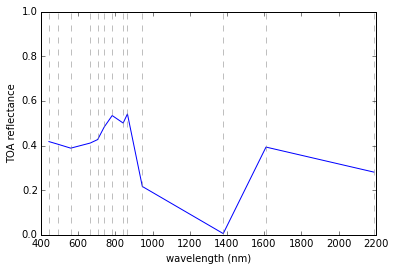

In [19]:
ind = np.random.choice(a)
p_x = w_p[0][ind]
p_y = w_p[1][ind]

plot_spec(p_x,p_y,bs)

In [250]:
wm[10000:,2000:].shape

(980, 8980)

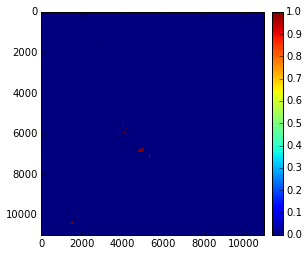

In [253]:
dimg(wm)

In [122]:
rgb = np.dstack((b4,b3,b2))

In [261]:
rgb[max(0,p_x-50):max(0,p_x+50), max(0,p_y-50):max(0,p_y+50),:].shape

(100, 100, 3)

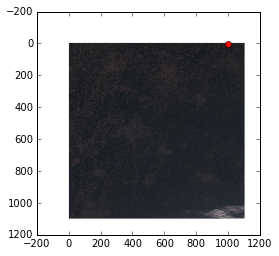

In [316]:
plt.imshow(rgb[::10,::10])
plt.plot(1000,1, 'ro')

In [30]:
w_p = np.where(vm)
a = np.arange(len(w_p[0]))

In [133]:
import numpy as np

def histe(rgb, number_bins=256):
    # from http://www.janeriksolem.net/2009/06/histogram-equalization-with-python-and.html
    x = np.zeros(rgb.shape)
    for i in range(1):
        image = rgb[:,:,i]
        image_histogram, bins = np.histogram(image.flatten(), number_bins, normed=True) # get image histogram
        cdf = image_histogram.cumsum() # cumulative distribution function
        cdf = 1. * cdf / cdf[-1] # normalize

        # use linear interpolation of cdf to find new pixel values
        image_equalized = np.interp(image.flatten(), bins[:-1], cdf)
        x[:,:,i] = image_equalized.reshape(image.shape)
    
    return x

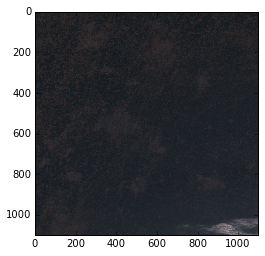

In [166]:
plt.imshow(rgb[::10,::10,:])

In [257]:
from scipy.ndimage.filters import gaussian_filter

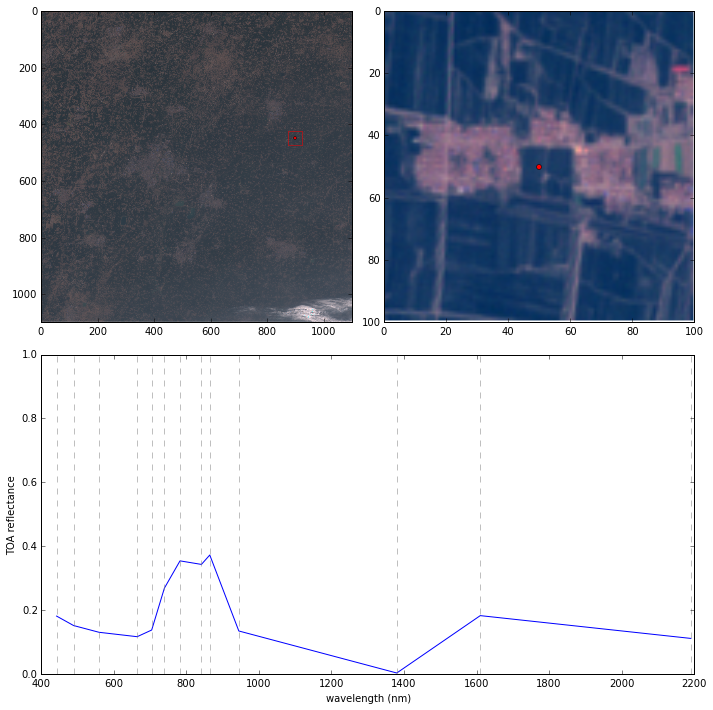

In [271]:
import matplotlib.patches as patches
from matplotlib import gridspec
import pylab as plt
ind = np.random.choice(a)
p_x = w_p[0][ind]
p_y = w_p[1][ind]

maxm = 1.
phi = 1.
theta = 1.3

plt.clf()
cmap = plt.get_cmap('gray')

fig = plt.figure(figsize=(10,10))
ax1 = plt.subplot2grid((2, 2), (0, 0))
ax2 = plt.subplot2grid((2, 2), (0, 1), colspan=2)
ax3 = plt.subplot2grid((2, 2), (1, 0), colspan=2, rowspan=2)

patch = patches.Rectangle((max(0,p_y/10.-25.), max(0,p_x/10.-25.)), 50,50,facecolor='none', linewidth=0.5, edgecolor = 'r')
ax1.add_patch(patch)
#p1 = rgb[::10,::10,:]
#plot1 = (p1-p1.min())/(p1.max()-p1.min())
plot1 = (((maxm)/phi)*(rgb[::10,::10,:]/(maxm/theta)))**0.9
ax1.imshow(plot1*1.2)
ax1.set_xlim([0, 1098])
ax1.set_ylim([1098, 0])
ax1.plot(p_y/10.,p_x/10.,'ro',markersize=2.8)

p2 = rgb[max(0,p_x-50):min(10980,p_x+50), max(0,p_y-50):min(10980,p_y+50),:]
plot2 = (p2-p2.min())/(p2.max()-p2.min())

ax2.imshow(plot2, interpolation=None)
ax2.set_xlim([0, 100])
ax2.set_ylim([100, 0])
ax2.plot(50,50,'ro',markersize=5)

p_r = []
for m in bs:
    p_r.append(m[p_x,p_y])
plt.plot(wl,p_r)
plt.ylim([0,1.])
plt.ylabel('TOA reflectance')
plt.xlabel('wavelength (nm)')
for i in wl:
    line = ax3.plot([i,i],[0,1],'--')
    plt.setp(line, linewidth=0.5, color='gray')

plt.tight_layout()

In [278]:
import matplotlib.patches as patches
from matplotlib import gridspec
import pylab as plt
def zoomindraw(m_name,mask,rgb,bands):
    maxm = 1.
    phi = 1.
    theta = 1.3

    for k in range(11):
        if k ==0:
            
            w_p = np.where(mask)
            a = np.arange(len(w_p[0]))
        else:
            ind = np.random.choice(a)
            p_x = w_p[0][ind]
            p_y = w_p[1][ind]

            
            cmap = plt.get_cmap('gray')

            fig = plt.figure(figsize=(10,10))
            ax1 = plt.subplot2grid((2, 2), (0, 0))
            ax2 = plt.subplot2grid((2, 2), (0, 1), colspan=2)
            ax3 = plt.subplot2grid((2, 2), (1, 0), colspan=2, rowspan=2)

            patch = patches.Rectangle((max(0,p_y/10.-25.), max(0,p_x/10.-25.)), 50+min(0,(p_y/10.-25.)),50+min(0,(p_x/10.-25.)),facecolor='none', linewidth=0.5, edgecolor = 'r')
            ax1.add_patch(patch)
            ax1.imshow(rgb[::10,::10,:]*1.7, interpolation =None)
            #plot1 = (((maxm)/phi)*(rgb[::10,::10,:]/(maxm/theta)))**0.9
            #ax1.imshow(plot1, interpolation = None)
            ax1.set_xlim([0, 1098])
            ax1.set_ylim([1098, 0])
            ax1.plot(p_y/10.,p_x/10.,'ro',markersize=2.8)
            
            
            p2 = rgb[max(0,p_x-50):min(10980,p_x+50), max(0,p_y-50):min(10980,p_y+50),:]
            plot2 = (p2-p2.min())/(p2.max()-p2.min())
            ax2.imshow(plot2, interpolation=None)
            ax2.set_xlim([0, 100])
            ax2.set_ylim([100, 0])
            ax2.plot(50,50,'ro',markersize=5)

            p_r = []
            for m in bs:
                p_r.append(m[p_x,p_y])
            plt.plot(wl,p_r)
            plt.ylim([0,1.])
            plt.ylabel('TOA reflectance')
            plt.xlabel('wavelength (nm)')
            for i in wl:
                line = ax3.plot([i,i],[0,1],'--')
                plt.setp(line, linewidth=0.5, color='gray')

            plt.tight_layout()
            plt.savefig('image/%s%i.pdf'%(m_name[:-1],k), format='pdf')

In [274]:
bands = [b1,b2,b3,b4,b5,b6,b7,b8,b8a,b9,b10,b11,b12]

/home/ucfafyi/.conda/envs/gdal_env/lib/python2.7/site-packages/matplotlib/pyplot.py:424: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


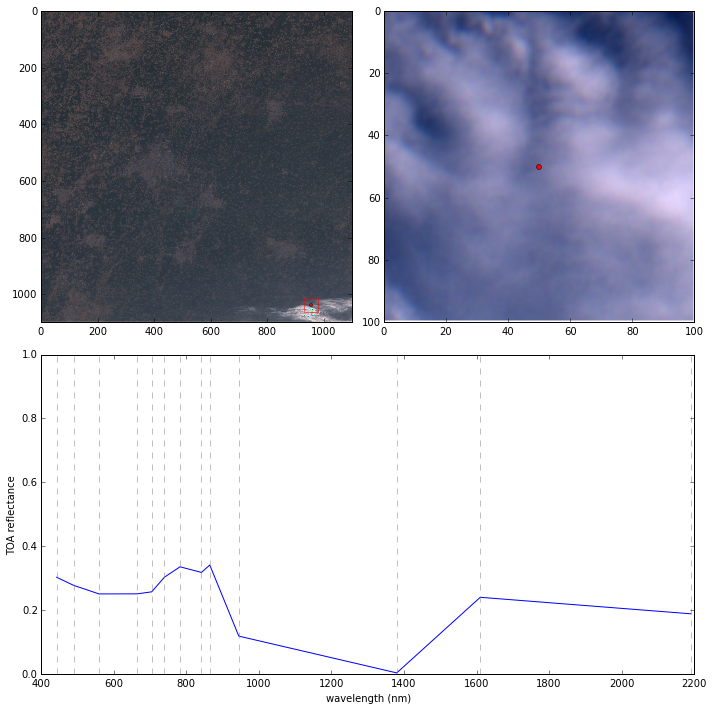

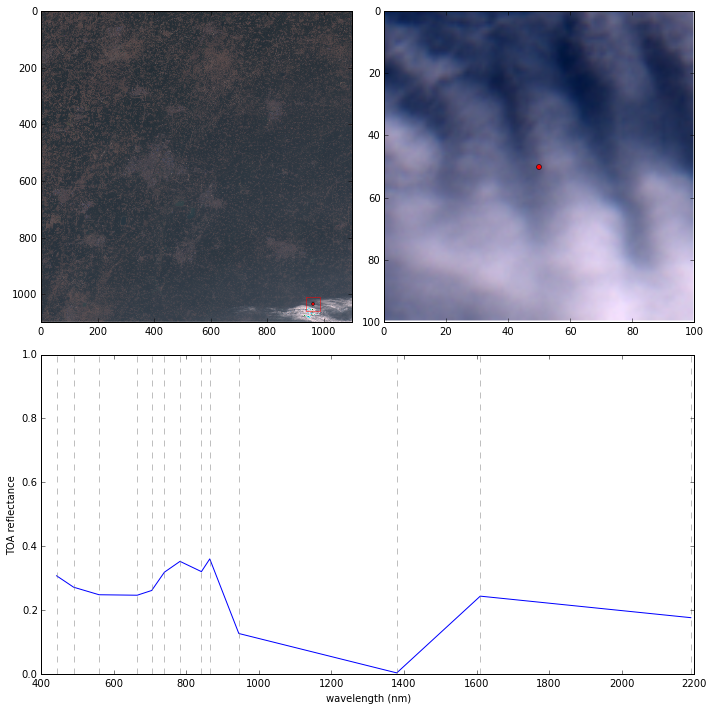

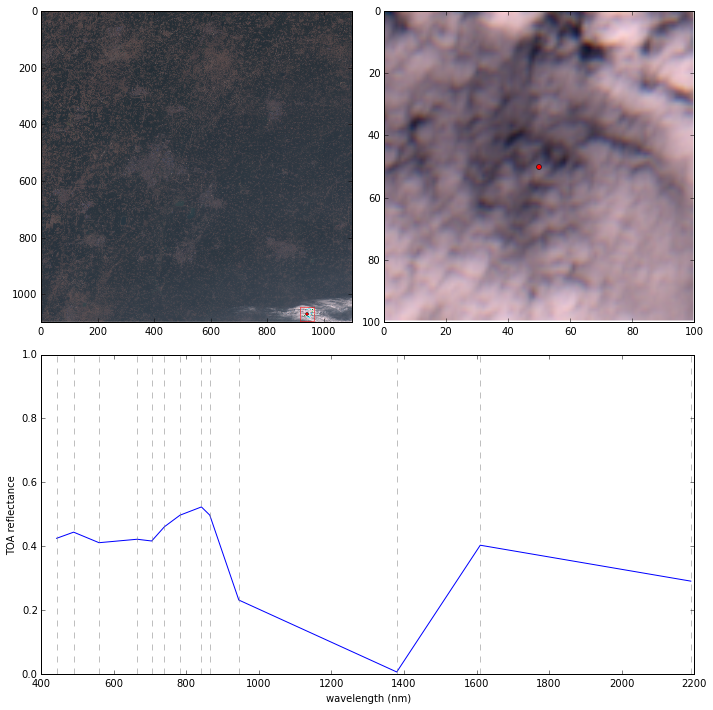

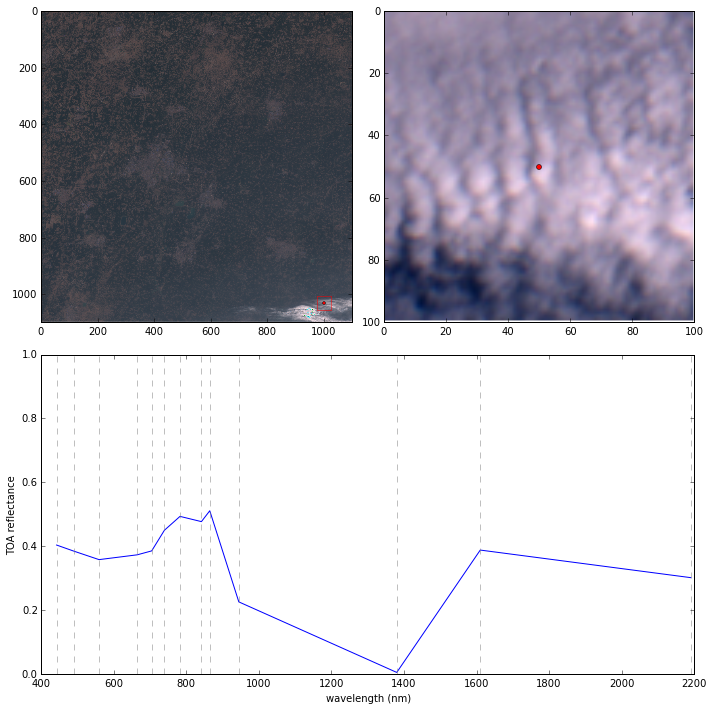

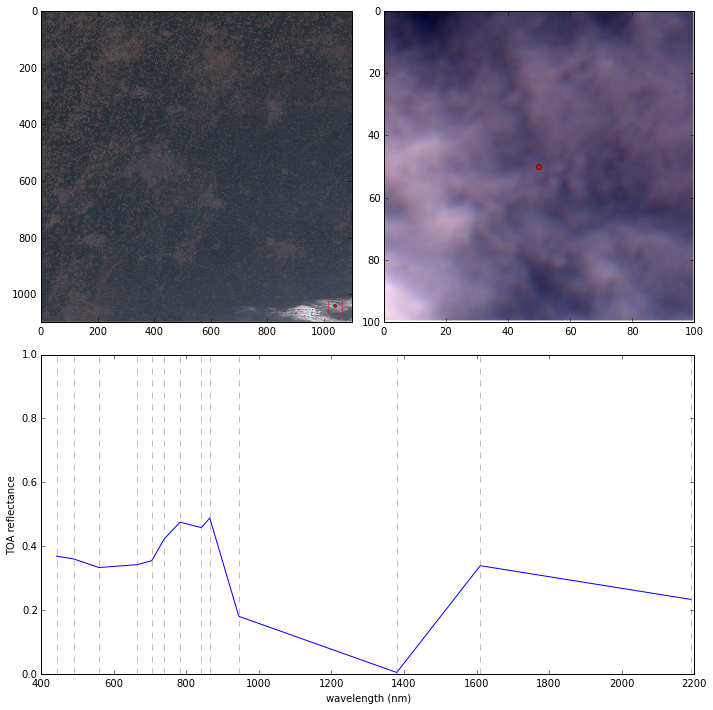

...

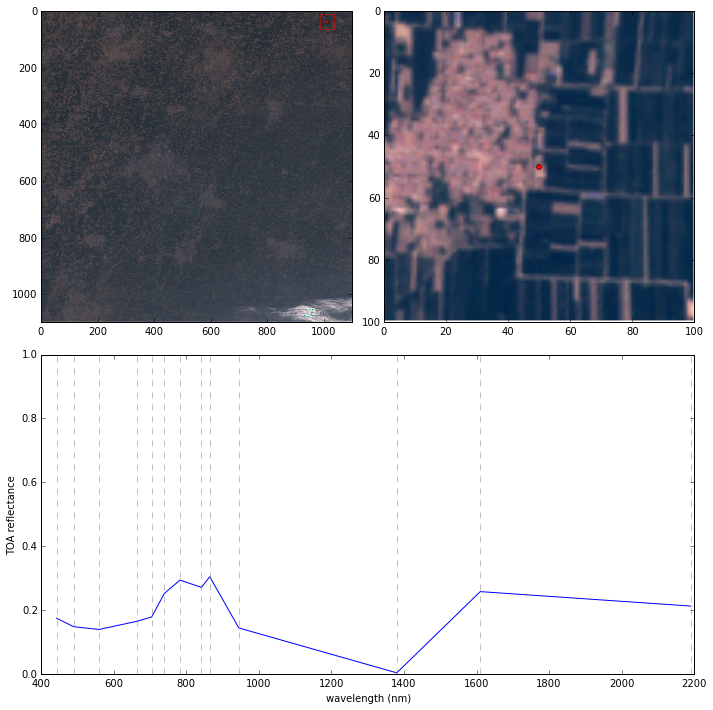

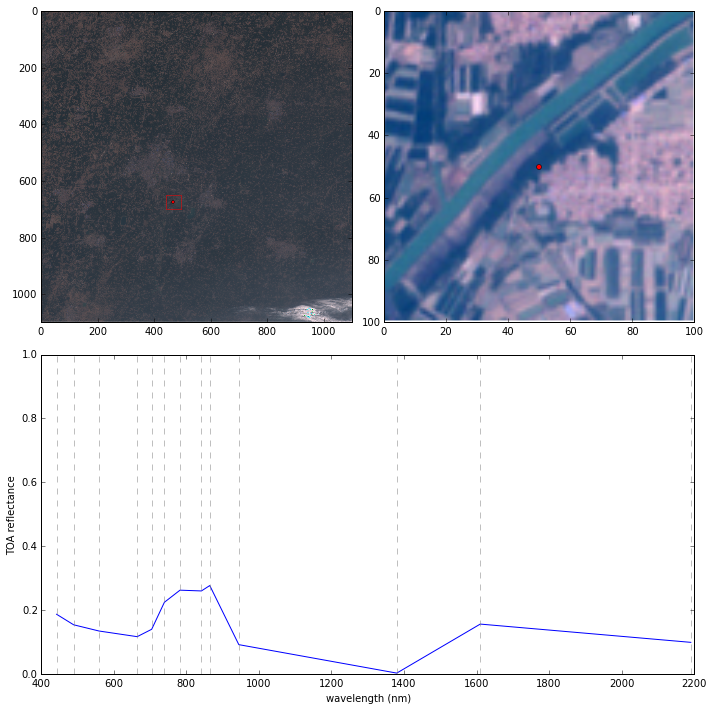

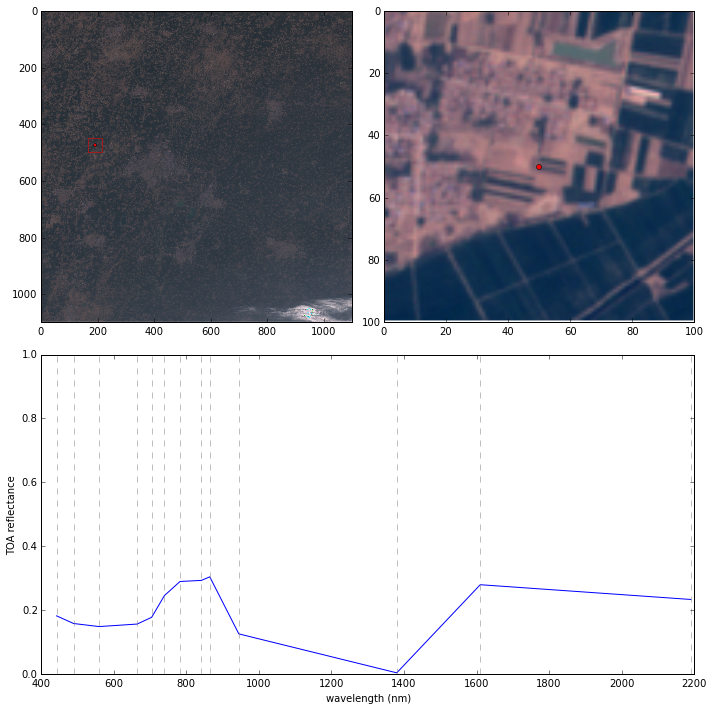

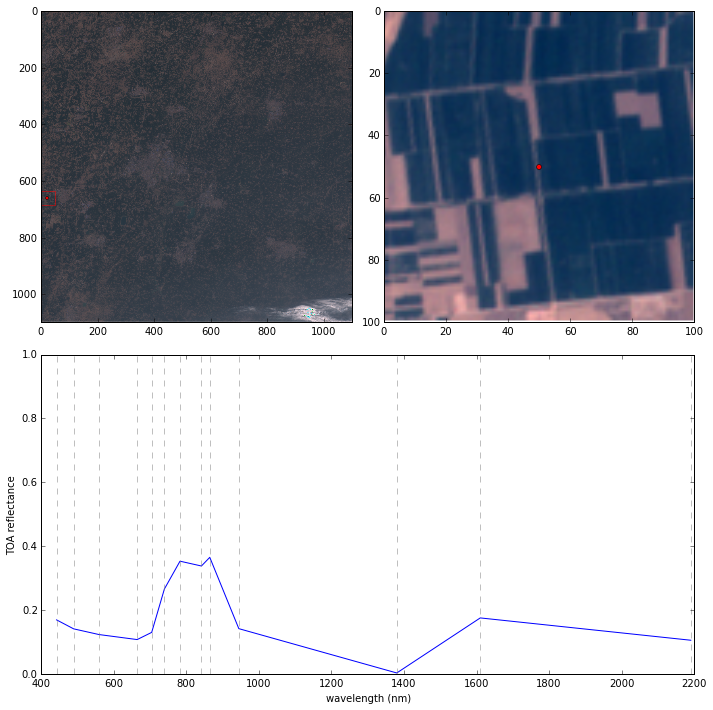

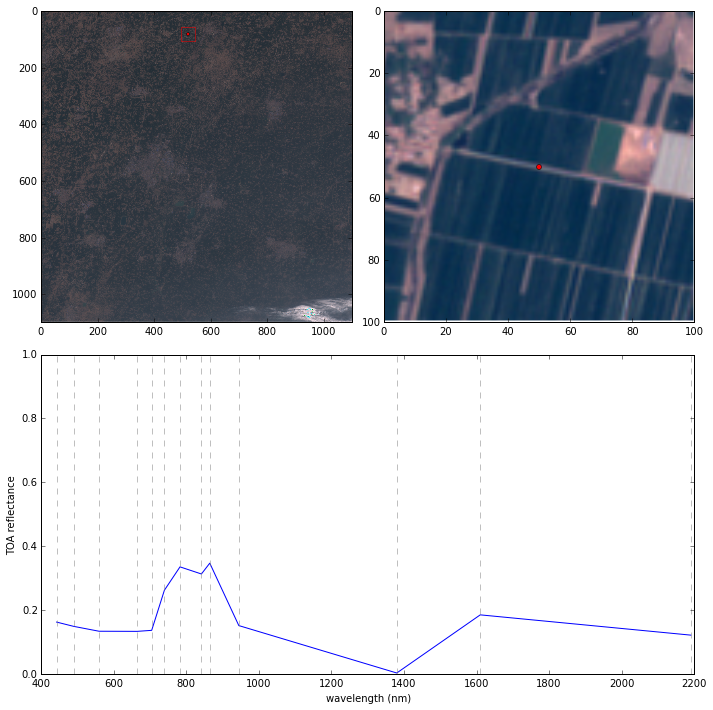

In [287]:
for i,j in zip(['cloud','water','bare_soil','Dss','veg'],[mc_m,wm,bsm,Dssm,vm]):
    zoomindraw(i,j,rgb,bands)

In [280]:
import matplotlib.patches as patches
from matplotlib import gridspec
import pylab as plt
def zoomindraw2(n_m,rgb,bands):
    maxm = 1.
    phi = 1.
    theta = 1.3
    
    m_name,mask = n_m
    
    for k in range(11):
        if k ==0:
            
            w_p = np.where(mask)
            a = np.arange(len(w_p[0]))
        else:
            ind = np.random.choice(a)
            p_x = w_p[0][ind]
            p_y = w_p[1][ind]

            
            cmap = plt.get_cmap('gray')

            fig = plt.figure(figsize=(10,10))
            ax1 = plt.subplot2grid((2, 2), (0, 0))
            ax2 = plt.subplot2grid((2, 2), (0, 1), colspan=2)
            ax3 = plt.subplot2grid((2, 2), (1, 0), colspan=2, rowspan=2)

            patch = patches.Rectangle((max(0,p_y/10.-25.), max(0,p_x/10.-25.)), 50+min(0,(p_y/10.-25.)),50+min(0,(p_x/10.-25.)),facecolor='none', linewidth=0.5, edgecolor = 'r')
            ax1.add_patch(patch)
            ax1.imshow(rgb[::10,::10,:]*1.7, interpolation =None)
            #plot1 = (((maxm)/phi)*(rgb[::10,::10,:]/(maxm/theta)))**0.9
            #ax1.imshow(plot1, interpolation = None)
            ax1.set_xlim([0, 1098])
            ax1.set_ylim([1098, 0])
            ax1.plot(p_y/10.,p_x/10.,'ro',markersize=2.8)
            
            
            p2 = rgb[max(0,p_x-50):min(10980,p_x+50), max(0,p_y-50):min(10980,p_y+50),:]
            plot2 = (p2-p2.min())/(p2.max()-p2.min())
            ax2.imshow(plot2, interpolation=None)
            ax2.set_xlim([0, 100])
            ax2.set_ylim([100, 0])
            ax2.plot(50,50,'ro',markersize=5)

            p_r = []
            for m in bs:
                p_r.append(m[p_x,p_y])
            plt.plot(wl,p_r)
            plt.ylim([0,1.])
            plt.ylabel('TOA reflectance')
            plt.xlabel('wavelength (nm)')
            for i in wl:
                line = ax3.plot([i,i],[0,1],'--')
                plt.setp(line, linewidth=0.5, color='gray')

            plt.tight_layout()
            plt.savefig('image/%s%i.pdf'%(m_name[:-1],k), format='pdf')

In [ ]:
import multiprocessing
from functools import partial

par = partial(zoomindraw2,[rgb,bands])
pool = multiprocessing.Pool(processes=10)
pool.map(par,zip(['cloud','water','bare_soil','Dss','veg'],[mc_m,wm,bsm,Dssm,vm]), 1)

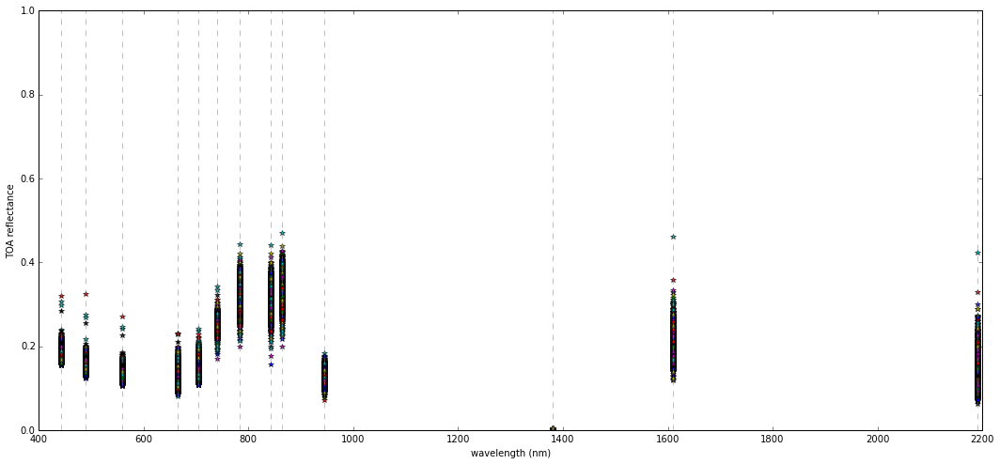

In [288]:
w_p = np.where(vm)
a = np.arange(len(w_p[0]))
inds=[]
p_rs = []
plt.figure(figsize=(18,8))
for i in range(1000):
    inds.append(np.random.choice(a))
    ind = np.random.choice(a)
    p_x = w_p[0][ind]
    p_y = w_p[1][ind]
    p_r = []
    for m in bands:
        p_r.append(m[p_x,p_y])
    p_rs.append(p_r)
    plt.plot(wl,p_r,'*')
    plt.ylim([0,1.])
    plt.ylabel('TOA reflectance')
    plt.xlabel('wavelength (nm)')

for i in wl:
    line =plt.plot([i,i],[0,1],'--')
    plt.setp(line, linewidth=0.5, color='gray')



In [291]:
p_rs = np.array(p_rs)
p_rs.shape

(1000, 13)

In [24]:
def adjust_spines(ax, spines):
    for loc, spine in ax.spines.items():
        if loc in spines:
            spine.set_position(('outward', 10))  # outward by 10 points
            spine.set_smart_bounds(True)
        else:
            spine.set_color('none')  # don't draw spine

    # turn off ticks where there is no spine
    if 'left' in spines:
        ax.yaxis.set_ticks_position('left')
    else:
        # no yaxis ticks
        ax.yaxis.set_ticks([])

    if 'bottom' in spines:
        ax.xaxis.set_ticks_position('bottom')
    else:
        # no xaxis ticks
        ax.xaxis.set_ticks([])

In [ ]:
from functools import partial

pars = partial(pkl_f,o = 'w')
pool = multiprocessing.Pool(processes=16)
pool.map(pars,bands)
pool.close()
pool.join()

names = [i+'.pkl' for i in 'b1,b2,b3,b4,b5,b6,b7,b8,b8a,b9,b10,b11,b12'.split(',')]
d = [b1,b2,b3,b4,b5,b6,b7,b8,b8a,b9,b10,b11,b12]
bands = [{i[0]:i[1]} for i in zip(names,d)]

In [21]:
import pickle
p_rs = pickle.load(open('pkls/veg_pixels.pkl'))

In [32]:
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches
import matplotlib

def adjust_spines(ax, spines):
    # for the use of set the axis of subplots
    for loc, spine in ax.spines.items():
        if loc in spines:
            spine.set_position(('outward', 10))  # outward by 10 points
            spine.set_smart_bounds(False)
        else:
            spine.set_color('none')  # don't draw spine

    # turn off ticks where there is no spine
    if 'left' in spines:
        ax.yaxis.set_ticks_position('left')
    else:
        # no yaxis ticks
        ax.yaxis.set_ticks([])

    if 'bottom' in spines:
        ax.xaxis.set_ticks_position('bottom')
        ax.xaxis.set_ticks([0,125,250])
    else:
        # no xaxis ticks
        ax.xaxis.set_ticks([])


def bandhist(pixels):
    '''
    Used to plot 13 bands of the sentinel 2 data 
    keywords arguments:
    pixels -- 13 bands values for a specific number of pixels, say 1000.
    line -- boolean whether plot a line cross all of the small subplots 
    return:
    nothing
    '''
    line = True
    gs1 = gridspec.GridSpec(1, 13)  # generate a grid space
    axs = [] 
    fig = plt.figure(figsize=(18,6))
    
    
    for i in range(13):
        ax = fig.add_subplot(gs1[i])
        ax.hist(pixels[:,i][pixels[:,i]>0.0001],orientation ='horizontal', bins=500,color='black', alpha = 1.)
        ax.plot(0.,pixels[:,i][pixels[:,i]>0.0001].mean(),'ro',markersize=5)
        rect = patches.Rectangle((0,pixels[:,i][pixels[:,i]>0.0001].mean())-np.std(pixels[:,i][pixels[:,i]>0.0001]), width=200, 
                                 height=2*np.std(pixels[:,i][pixels[:,i]>0.0001]), color='grey', alpha=0.25)

        ax.add_patch(rect)
        ax.set_ylim(0, 0.6)
        ax.set_xlim(0, 200)
        axs.append(ax)
        if i==0:
            adjust_spines(axs[i], ['left', 'bottom'])
        elif i==12:
            adjust_spines(axs[i], [ 'bottom'])
        else:
            adjust_spines(axs[i], ['bottom'])
    
    if line:
        transFigure = fig.transFigure.inverted()
        coords = []
        for i in range(13):
            coords.append(transFigure.transform(axs[i].transData.transform([0.,pixels[:,i][pixels[:,i]>0.0001].mean()])))

        coords = np.array(coords)
        line = matplotlib.lines.Line2D(coords[:,0],coords[:,1],transform=fig.transFigure,
                                       color='gray', linestyle = '-.',linewidth = 0.5)
        fig.lines = line,
    
    
    plt.savefig('image/%s.pdf'%('year_veg'), format='pdf')

In [ ]:
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches
import matplotlib

gs1 = gridspec.GridSpec(1, 13)
axs = []
fig = plt.figure(figsize=(18,6))
transFigure = fig.transFigure.inverted()

for i in range(13):
    ax = fig.add_subplot(gs1[i])
    ax.hist(p_rs[:,i][p_rs[:,i]>0.].mean(),orientation ='horizontal', bins=500,color='black', alpha = 1.)
    ax.plot(0.,p_rs[:,i][p_rs[:,i]>0.].mean(),'ro',markersize=5)
    rect = patches.Rectangle((0,p_rs[:,i][p_rs[:,i]>0.].mean()-np.std(p_rs[:,i][p_rs[:,i]>0.])), width=200, height=2*np.std(p_rs[:,i]), color='grey',
                         alpha=0.25)

    ax.add_patch(rect)
    ax.set_ylim(0, 0.6)
    ax.set_xlim(0, 200)
    axs.append(ax)
    if i==0:
        adjust_spines(axs[i], ['left', 'bottom'])
    elif i==12:
        adjust_spines(axs[i], [ 'bottom'])
    else:
        adjust_spines(axs[i], ['bottom'])
        
coords = []
for i in range(13):
    coords.append(transFigure.transform(axs[i].transData.transform([0.,p_rs[:,i].mean()])))

coords = np.array(coords)
line = matplotlib.lines.Line2D(coords[:,0],coords[:,1],transform=fig.transFigure,
                               color='gray', linestyle = '-.',linewidth = 0.5)
fig.lines = line,

(0, 0.005)

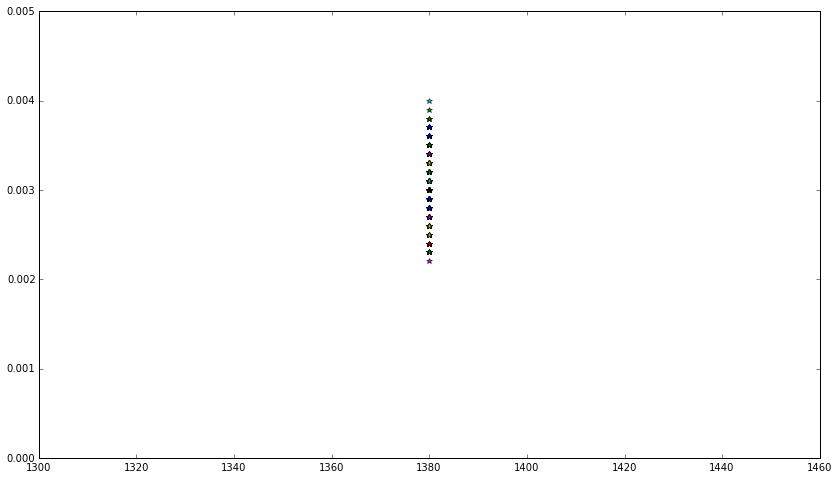

In [455]:
#band 10
plt.figure(figsize=(14,8))
for i in p_rs:
    plt.plot(wl[-3],i[-3],'*')
plt.ylim([0,0.005])

In [ ]:
'''def cartesian(arrays, out=None):
    """
    Generate a cartesian product of input arrays.

    Parameters
    ----------
    arrays : list of array-like
        1-D arrays to form the cartesian product of.
    out : ndarray
        Array to place the cartesian product in.

    Returns
    -------
    out : ndarray
        2-D array of shape (M, len(arrays)) containing cartesian products
        formed of input arrays.

    Examples
    --------
    >>> cartesian(([1, 2, 3], [4, 5], [6, 7]))
    array([[1, 4, 6],
           [1, 4, 7],
           [1, 5, 6],
           [1, 5, 7],
           [2, 4, 6],
           [2, 4, 7],
           [2, 5, 6],
           [2, 5, 7],
           [3, 4, 6],
           [3, 4, 7],
           [3, 5, 6],
           [3, 5, 7]])

    """

    arrays = [np.asarray(x) for x in arrays]
    dtype = arrays[0].dtype

    n = np.prod([x.size for x in arrays])
    if out is None:
        out = np.zeros([n, len(arrays)], dtype=dtype)

    m = n / arrays[0].size
    out[:,0] = np.repeat(arrays[0], m)
    if arrays[1:]:
        cartesian(arrays[1:], out=out[0:m,1:])
        for j in xrange(1, arrays[0].size):
            out[j*m:(j+1)*m,1:] = out[0:m,1:]
    return out
'''

In [ ]:
# build a function to read in a time serials of tile pixels and random sample the 
#1000 pixels for each day with 13 bands value stored. 
import sys
sys.path.insert(0,'python')
from readSent import *
from classification import *
import cPickle as pkl
import numpy as np
import glob
import multiprocessing
from functools import partial



def ScaleExtent( data): # used for unifine different array, 
    shape = (10980,10980)
    re = int(shape[0]/(data.shape[0]))
    return np.repeat(np.repeat(data, re, axis = 1), re, axis =0)


def pkl_f(f_wr, o = None):
    if o == 'r':
        return pkl.load(open(f_wr, 'rb'))
    elif o == 'w':
        pkl.dump(f_wr.values()[0], open(f_wr.keys()[0], 'wb'))
    else:
        print "please specify operation as 'r'or 'w' for reading and writing"  

def get_veg(fhead):
    
    img = readfile(range(1,14),fhead)
    b2 = img['B02']
    b4 = img['B04']
    b3 = img['B03']
    b8 = img['B08']
    b11 = img['B11']
    b12 = img['B12']
    b8a = img['B8A']
    b5 = img['B05']
    b6 = img['B06']
    b10 = img['B10']
    b9 = img['B09']
    b7 = img['B07']
    b1 = img['B01']

    e_b = []
    for i in [b1,b5,b6,b7,b9,b10,b8a,b11,b12]:
        e_b.append(ScaleExtent(i))
    b1,b5,b6,b7,b9,b10,b8a,b11,b12 = e_b
    bands = [b1,b2,b3,b4,b5,b6,b7,b8,b8a,b9,b10,b11,b12]
    
    l = classification(img = img)
    l._p8()
    l._p9()
    vm = l.vm & ~l.p9m
    
    w_p = np.where(vm)
    a = np.arange(len(w_p[0]))
    inds=[]
    p_rs = []
   
    for i in range(1000):
        ind = np.random.choice(a)
        inds.append(ind)
        p_x = w_p[0][ind]
        p_y = w_p[1][ind]
        p_r = []
        for m in bands:
            p_r.append(m[p_x,p_y])
        p_rs.append(p_r)
    
    
    
    pkl_f({'pkls/%spixels.pkl'%fhead[5:]: p_rs}, 'w')
    pkl_f({'pkls/%sinds.pkl'%fhead[5:]: inds}, 'w')
    pkl_f({'pkls/%svm.pkl'%fhead[5:]: vm}, 'w')

fheads= [i.split('B01')[0] for i in glob.glob('data/50SMG*B01.jp2')]
for i in fheads:
    get_veg(i)
    print 'finished %s'%i

In [5]:
import glob
fheads= ['pkls/'+i.split('B01')[0][5:] +'pixels.pkl' for i in glob.glob('data/50SMG*B01.jp2')]

In [6]:
len(fheads)

23

In [11]:
import cPickle as pkl
def pkl_f(f_wr):
    return pkl.load(open(f_wr, 'rb'))
   

In [9]:
def pkl_f(f_wr, o = None):
    if o == 'r':
        return pkl.load(open(f_wr['name'], 'rb'))
    elif o == 'w':
        pkl.dump(f_wr.values()[0], open(f_wr.keys()[0], 'wb'))
    else:
        print "please specify operation as 'r'or 'w' for reading and writing"

In [12]:
from functools import partial
from multiprocessing import Pool
pool = Pool(processes=16)
pixels = pool.map(pkl_f, fheads)
pool.close()
pool.join()

In [ ]:
get_veg('data/50SMG2016110')

In [65]:
pixels = pkl_f('pkls/50SMG2016110pixels.pkl','r')

In [13]:
fnames = ['image' + i.split('pixels')[0][4:] +'.pdf' for i in fheads]

In [14]:
pls = [{i:j} for i,j in zip(fnames,pixels)]

In [15]:
import numpy as np
pixels = np.array(pls[0].values()[0])
pixels.shape

(1000, 13)

In [24]:
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches
import matplotlib
import pylab as plt

def adjust_spines(ax, spines):
    # for the use of set the axis of subplots
    for loc, spine in ax.spines.items():
        if loc in spines:
            spine.set_position(('outward', 10))  # outward by 10 points
            spine.set_smart_bounds(False)
        else:
            spine.set_color('none')  # don't draw spine

    # turn off ticks where there is no spine
    if 'left' in spines:
        ax.yaxis.set_ticks_position('left')
    else:
        # no yaxis ticks
        ax.yaxis.set_ticks([])

    if 'bottom' in spines:
        ax.xaxis.set_ticks_position('bottom')
        #ax.xaxis.set_ticks([0,250,500])
    else:
        # no xaxis ticks
        ax.xaxis.set_ticks([])


def bandhist(p,a):
    '''
    Used to plot 13 bands of the sentinel 2 data 
    keywords arguments:
    pixels -- 13 bands values for a specific number of pixels, say 1000.
    line -- boolean whether plot a line cross all of the small subplots 
    return:
    nothing
    '''

    line = True
    pixels = np.array(a.values()[0])
    pl=p
    

    gs1 = gridspec.GridSpec(1, 13)  # generate a grid space
    axs = [] 
    fig = plt.figure(figsize=(18,6))
    
    for i in range(13):
        ax = fig.add_subplot(gs1[i])
        if len(pixels[:,i][pixels[:,i]>0.0001])<10:
            pass
        else:
            ax.hist(pixels[:,i][pixels[:,i]>0.0001],orientation ='horizontal', bins=500,color='black', alpha = 1.)
        ax.plot(0.,pixels[:,i][pixels[:,i]>0.0001].mean(),'ro',markersize=5)
        ax.plot(0., pl[:,i][pl[:,i]>0.0001].mean(), 'bo',markersize=10, alpha=0.25)
        rect1 = patches.Rectangle((0, pixels[:,i][pixels[:,i]>0.0001].mean()-np.std(pixels[:,i][pixels[:,i]>0.0001])), width=20, 
                                 height=2*np.std(pixels[:,i][pixels[:,i]>0.0001]), color='gray', alpha=0.25)
        
        rect2 = patches.Rectangle((0,pl[:,i][pl[:,i]>0.0001].mean()-np.std(pl[:,i][pl[:,i]>0.0001])), width=20, 
                                 height=2*np.std(pl[:,i][pl[:,i]>0.0001]), color='gray', alpha=0.25)

        ax.add_patch(rect1)
        ax.add_patch(rect2)
        ax.set_ylim(0, 0.6)
        ax.set_xlim(0, 20)
        #ax.set_xlim(0, 500)
        axs.append(ax)
        if i==0:
            adjust_spines(axs[i], ['left', 'bottom'])
        elif i==12:
            adjust_spines(axs[i], [ 'bottom'])
        else:
            adjust_spines(axs[i], ['bottom'])
    
    if line:
        transFigure = fig.transFigure.inverted()
        coords = []
        for i in range(13):
            coords.append(transFigure.transform(axs[i].transData.transform([0.,pixels[:,i][pixels[:,i]>0.0001].mean()])))

        coords = np.array(coords)
        line = matplotlib.lines.Line2D(coords[:,0],coords[:,1],transform=fig.transFigure,
                                       color='gray', linestyle = '-.',linewidth = 0.5)
        fig.lines = line,
    

    plt.savefig(a.keys()[0], format='pdf')

In [16]:
np.array(pls[0].values()[0]).shape

(1000, 13)

In [17]:
a = pls[0]

In [218]:
partial?

In [25]:
from functools import partial
from multiprocessing import Pool
par = partial(bandhist,pl.values()[0])
pool = Pool(processes=16)
pixels = pool.map(par,pls)
pool.close()
pool.join()

/home/ucfafyi/.conda/envs/gdal_env/lib/python2.7/site-packages/numpy/core/_methods.py:59: RuntimeWarning: Mean of empty slice.
  warnings.warn("Mean of empty slice.", RuntimeWarning)
/home/ucfafyi/.conda/envs/gdal_env/lib/python2.7/site-packages/numpy/core/_methods.py:59: RuntimeWarning: Mean of empty slice.
  warnings.warn("Mean of empty slice.", RuntimeWarning)
/home/ucfafyi/.conda/envs/gdal_env/lib/python2.7/site-packages/numpy/core/_methods.py:59: RuntimeWarning: Mean of empty slice.
  warnings.warn("Mean of empty slice.", RuntimeWarning)
/home/ucfafyi/.conda/envs/gdal_env/lib/python2.7/site-packages/numpy/core/_methods.py:59: RuntimeWarning: Mean of empty slice.
  warnings.warn("Mean of empty slice.", RuntimeWarning)
/home/ucfafyi/.conda/envs/gdal_env/lib/python2.7/site-packages/numpy/core/_methods.py:59: RuntimeWarning: Mean of empty slice.
  warnings.warn("Mean of empty slice.", RuntimeWarning)
/home/ucfafyi/.conda/envs/gdal_env/lib/python2.7/site-packages/numpy/core/_methods.py

In [19]:
y_v = [i.values()[0] for i in pls]

In [20]:
y_v = np.array(y_v)
y_v = y_v.reshape(23000,13)

In [21]:
pl = {'year_veg.pdf':y_v}

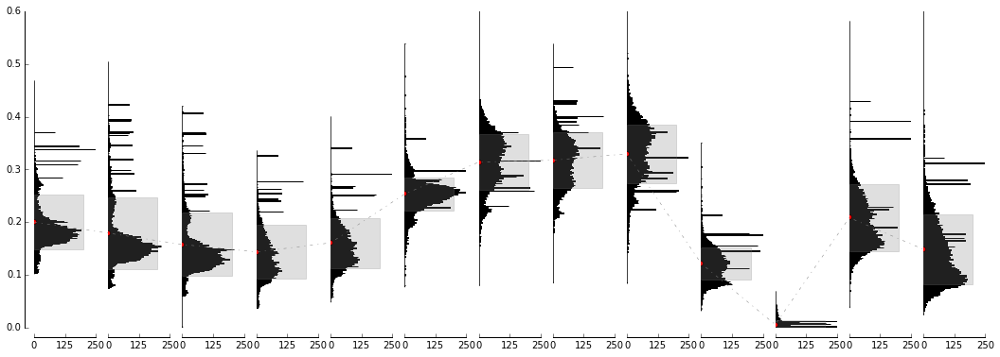

In [33]:
import pylab as plt
%matplotlib inline
bandhist(y_v)

In [58]:
np.unique(y_v[:,1])

array([ 0.    ,  0.0742,  0.0751, ...,  0.4704,  0.4919,  0.5049])

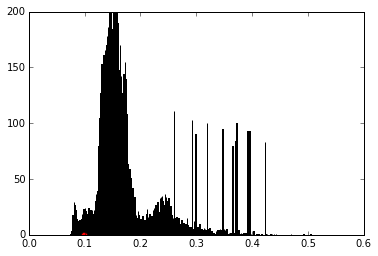

In [55]:
a,b,c = plt.hist(y_v[:,1], bins = 500)
plt.ylim(0, 200)
plt.plot(np.nanmean(y_v[:,1]),0, 'ro')

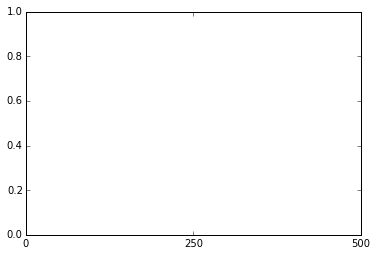

In [154]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.xaxis.set_ticks([0,250,500])

In [262]:
a = np.array([i.values()[0] for i in pls])

In [287]:
import scipy.stats
scipy.stats.kruskal(a[0][:,0],a[1][:,0],a[2][:,0],a[3][:,0],a[4][:,0],a[5][:,0],a[6][:,0],
                    a[7][:,0],a[8][:,0],a[9][:,0],a[10][:,0],a[11][:,0],a[12][:,0])                

KruskalResult(statistic=8.7011748134414315, pvalue=0.72821989151336552)

In [ ]:
import glob
fheads= ['pkls/'+i.split('B01')[0][5:] +'vm.pkl' for i in glob.glob('data/50SMG*B01.jp2')]
from functools import partial
from multiprocessing import Pool
import cPickle as pkl

def pkl_f(f_wr):
    return pkl.load(open(f_wr, 'rb'))
   
pool = Pool(processes=16)
pixels = pool.map(pkl_f, fheads)
pool.close()
pool.join()

In [ ]:
vm = pixels[14]

In [47]:
inds = pixels[14]

In [45]:
for i in pls:
    print i.keys(), pls.index(i)

 ['image/50SMG20151250.pdf'] 0
['image/50SMG201512220.pdf'] 1
['image/50SMG201512250.pdf'] 2
['image/50SMG2016110.pdf'] 3
['image/50SMG2016140.pdf'] 4
['image/50SMG20161140.pdf'] 5
['image/50SMG20161210.pdf'] 6
['image/50SMG20161240.pdf'] 7
['image/50SMG20161310.pdf'] 8
['image/50SMG2016230.pdf'] 9
['image/50SMG20162100.pdf'] 10
['image/50SMG2016340.pdf'] 11
['image/50SMG20163210.pdf'] 12
['image/50SMG2016430.pdf'] 13
['image/50SMG20164100.pdf'] 14
['image/50SMG20164130.pdf'] 15
['image/50SMG20164200.pdf'] 16
['image/50SMG20164230.pdf'] 17
['image/50SMG20164300.pdf'] 18
['image/50SMG2016530.pdf'] 19
['image/50SMG20165100.pdf'] 20
['image/50SMG20165130.pdf'] 21
['image/50SMG20165230.pdf'] 22


In [ ]:
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches
import matplotlib

def adjust_spines(ax, spines):
    # for the use of set the axis of subplots
    for loc, spine in ax.spines.items():
        if loc in spines:
            spine.set_position(('outward', 10))  # outward by 10 points
            spine.set_smart_bounds(False)
        else:
            spine.set_color('none')  # don't draw spine

    # turn off ticks where there is no spine
    if 'left' in spines:
        ax.yaxis.set_ticks_position('left')
    else:
        # no yaxis ticks
        ax.yaxis.set_ticks([])

    if 'bottom' in spines:
        ax.xaxis.set_ticks_position('bottom')
        ax.xaxis.set_ticks([0,125,250])
    else:
        # no xaxis ticks
        ax.xaxis.set_ticks([])


def bandhist(pixels):
    '''
    Used to plot 13 bands of the sentinel 2 data 
    keywords arguments:
    pixels -- 13 bands values for a specific number of pixels, say 1000.
    line -- boolean whether plot a line cross all of the small subplots 
    return:
    nothing
    '''
    line = True
    gs1 = gridspec.GridSpec(1, 13)  # generate a grid space
    axs = [] 
    fig = plt.figure(figsize=(18,6))
    
    
    for i in range(13):
        ax = fig.add_subplot(gs1[i])
        ax.hist(pixels[:,i][pixels[:,i]>0.0001],orientation ='horizontal', bins=500,color='black', alpha = 1.)
        ax.plot(0.,pixels[:,i][pixels[:,i]>0.0001].mean(),'ro',markersize=5)
        rect = patches.Rectangle((0,pixels[:,i][pixels[:,i]>0.0001].mean())-np.std(pixels[:,i][pixels[:,i]>0.0001]), width=200, 
                                 height=2*np.std(pixels[:,i][pixels[:,i]>0.0001]), color='grey', alpha=0.25)

        ax.add_patch(rect)
        ax.set_ylim(0, 0.6)
        ax.set_xlim(0, 200)
        axs.append(ax)
        if i==0:
            adjust_spines(axs[i], ['left', 'bottom'])
        elif i==12:
            adjust_spines(axs[i], [ 'bottom'])
        else:
            adjust_spines(axs[i], ['bottom'])
    
    if line:
        transFigure = fig.transFigure.inverted()
        coords = []
        for i in range(13):
            coords.append(transFigure.transform(axs[i].transData.transform([0.,pixels[:,i][pixels[:,i]>0.0001].mean()])))

        coords = np.array(coords)
        line = matplotlib.lines.Line2D(coords[:,0],coords[:,1],transform=fig.transFigure,
                                       color='gray', linestyle = '-.',linewidth = 0.5)
        fig.lines = line,
    
    
    plt.savefig('image/%s.pdf'%('year_veg'), format='pdf')